In [1]:
import numpy as np
import pandas as pd
import os 
import matplotlib.pyplot as plt
import seaborn as sns

import scanpy as sc 


In [2]:
# # path to  data 
data_path = "/home/t/tandrew6/btchatch/.$SCRATCH/spatial/Kerfoot_HD_Visium/pp/SC55_probe2_long"
out_dir = "/home/t/tandrew6/btchatch/project/MS/results"
sc.settings.figdir = out_dir
sc.settings.set_figure_params(dpi=100, dpi_save=150, format='png', fontsize=12)

In [3]:
# list all files in the directory
files = os.listdir(data_path)
files 

['res_pp_SC55_probe2_long_02.h5ad',
 'pp_SC55_probe2_long_16.h5ad',
 'raw_data',
 'pp_SC55_probe2_long_08.h5ad']

In [4]:
# read data
raw_SC55_16 = sc.read_h5ad(os.path.join(data_path, "raw_data/raw_SC55_probe2_long_16.h5ad"))
raw_SC55_16.var_names_make_unique()

/gpfs/fs1/home/t/tandrew6/btchatch/env/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [5]:
data = raw_SC55_16 
raw_SC55_16

AnnData object with n_obs × n_vars = 149261 × 19059
    obs: 'in_tissue', 'array_row', 'array_col'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatial'
    obsm: 'spatial'

In [6]:
# # writing pixel coordinates to file
# obsm_16 = pd.DataFrame(raw_SC55_16.obsm["spatial"])
# obsm_16.to_csv(os.path.join(out_dir, "obs_16.csv"), index=False, header=False)

In [7]:
# preprocessing steps: filtering cells and genes, calculating qc metrics, highly variable genes
SC55_16_filtered = data
sc.pp.filter_cells(SC55_16_filtered, min_genes=10)
sc.pp.filter_genes(SC55_16_filtered, min_cells=5)
sc.pp.calculate_qc_metrics(SC55_16_filtered, percent_top= [500], log1p=False, inplace=True)
sc.pp.highly_variable_genes(SC55_16_filtered, flavor="seurat_v3", n_top_genes=2000, inplace=True)
SC55_16_filtered = SC55_16_filtered[:, SC55_16_filtered.var.highly_variable] # subset highly variable genes
SC55_16_filtered

View of AnnData object with n_obs × n_vars = 38012 × 2000
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'spatial', 'hvg'
    obsm: 'spatial'

`n_genes_by_counts`: This is the number of genes detected (i.e have at least 1 count) in each spot. A high value means that more genes where detected in that spot.
`total_counts`: The total number of counts or reads in a spot. 

/gpfs/fs1/home/t/tandrew6/btchatch/env/spatial/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


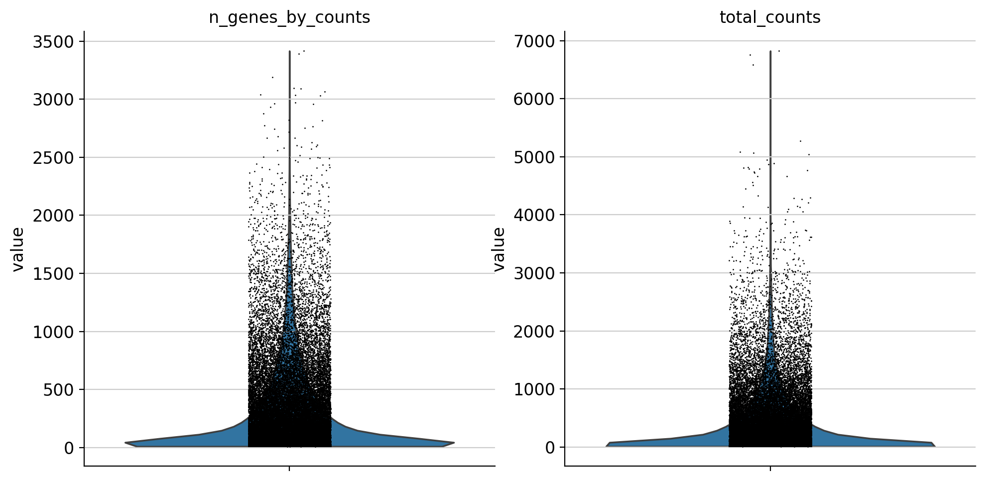

In [8]:
sc.pl.violin(SC55_16_filtered, ['n_genes_by_counts', 'total_counts'],  multi_panel=True, save="_QC_metrics")

In [9]:
SC55_16_filtered.obs['total_counts'].describe()

count    38012.000000
mean       375.380127
std        536.555542
min          9.000000
25%         26.000000
50%        157.000000
75%        506.000000
max       6824.000000
Name: total_counts, dtype: float64

In [10]:
sc.pp.filter_cells(SC55_16_filtered, min_genes=5) # retain spots with > 5 high variable genes
SC55_16_filtered.obs['total_counts'].describe()

/gpfs/fs1/home/t/tandrew6/btchatch/env/spatial/lib/python3.11/site-packages/scanpy/preprocessing/_simple.py:160: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["n_genes"] = number


count    29290.000000
mean       482.020996
std        569.229431
min         10.000000
25%         98.000000
50%        280.000000
75%        653.000000
max       6824.000000
Name: total_counts, dtype: float64

In [11]:
# normalizing data, log1p transformation
sc.pp.normalize_total(SC55_16_filtered)
sc.pp.log1p(SC55_16_filtered)

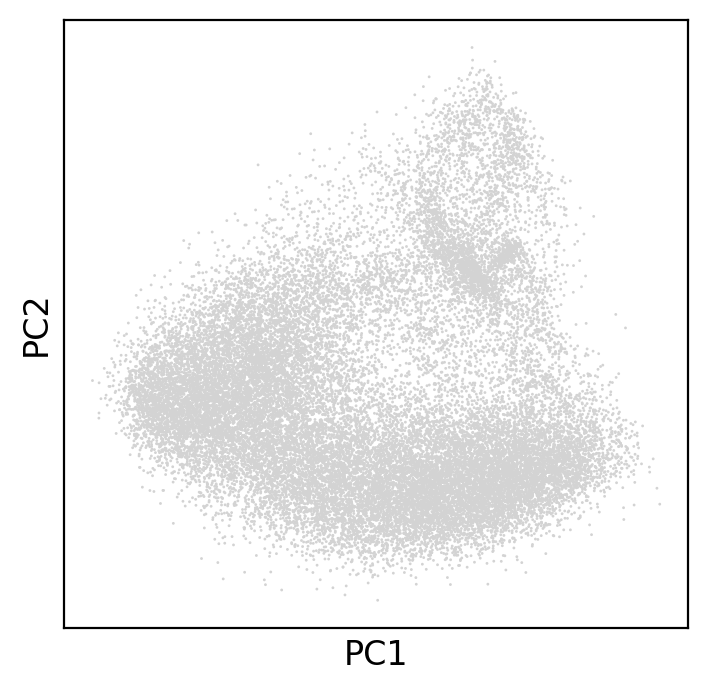

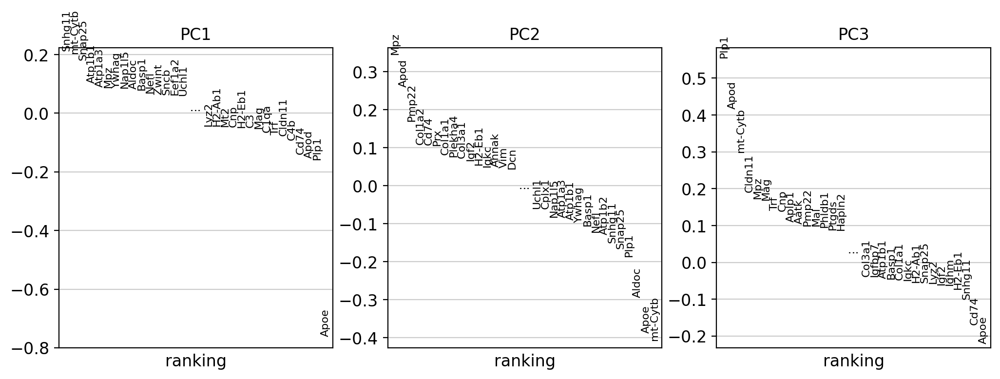

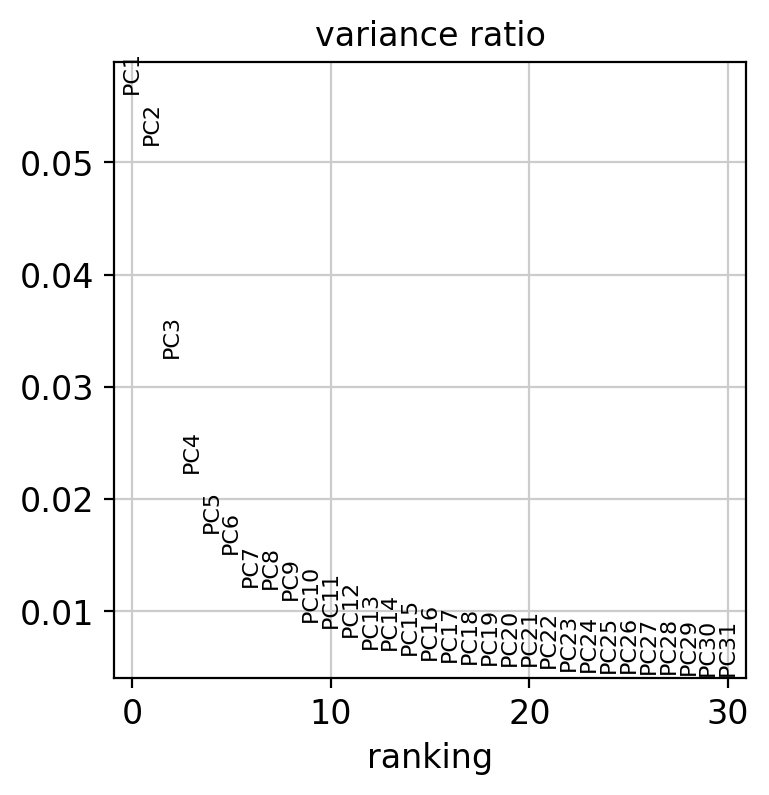

In [12]:
# PCA
sc.tl.pca(SC55_16_filtered, mask_var="highly_variable")
sc.pl.pca_overview(SC55_16_filtered)

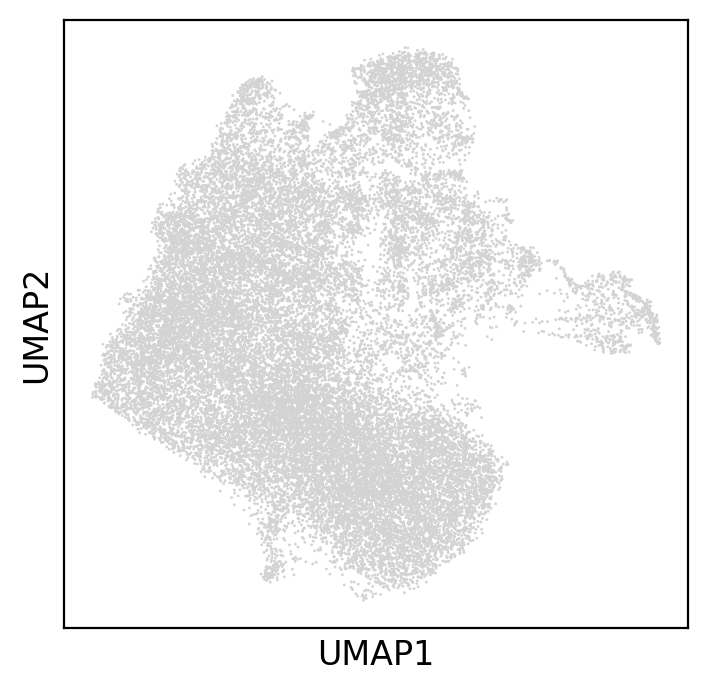

In [13]:
# UMAP
sc.pp.neighbors(SC55_16_filtered)
sc.tl.umap(SC55_16_filtered)
sc.pl.umap(SC55_16_filtered)

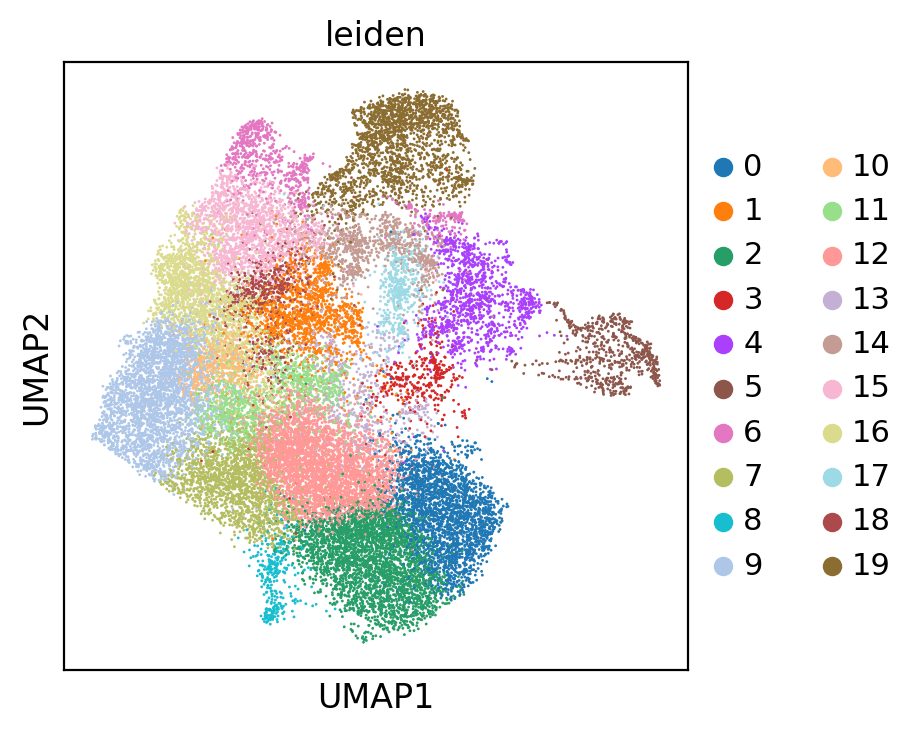

In [14]:
# leiden clustering at resolution=1
sc.tl.leiden(SC55_16_filtered, flavor= "igraph", n_iterations=2, directed=False)
sc.pl.umap(SC55_16_filtered, color=['leiden'], save="_leiden")

In [15]:
sc.tl.rank_genes_groups(SC55_16_filtered, 'leiden', method='wilcoxon')

In [16]:
result = SC55_16_filtered.uns['rank_genes_groups']
groups = result['names'].dtype.names  # cluster names
genes_df = pd.DataFrame(
    {group: result['names'][group] for group in groups}
)
genes_df.head(10)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
0,Snhg11,Apoe,Snap25,mt-Cytb,Igkc,Acta1,Cd74,Plp1,Nefl,Plp1,Plp1,mt-Cytb,Aldoc,Pltp,Ptgds,Cd74,Apoe,Apod,Apod,Mpz
1,Basp1,Hbb-bs,Atp1b1,Hba-a2,Hbb-bs,Tnnt3,Ighm,Ptgds,Nefh,Apod,Apoe,Apoe,mt-Cytb,Igfbp7,Igf2,Igf2,Cd74,Igkc,Apoe,Pmp22
2,Nap1l5,Hba-a2,Snhg11,Hbb-bt,Glycam1,Atp2a1,Igkc,mt-Cytb,Nefm,Cldn11,Flnc,Plp1,Atp1b2,Cldn5,Col1a2,Col1a1,C1qa,Prx,Col3a1,Prx
3,Ly6h,Cfd,Atp1a3,Muc13,Hbb-bt,Ckm,H2-Eb1,Mag,Ywhag,Trf,Ntn5,Artn,Nefl,Col4a1,Col1a1,Apoe,C3,Pmp22,Igkc,Apod
4,Snap25,Itih2,Ywhag,Sytl3,Hba-a2,Tnnc2,H2-Ab1,Cldn11,Map1b,Mag,Cox8b,Il15,Mt2,Slc2a1,Col3a1,H2-Eb1,C4b,Igfbp6,Cfh,Plekha4
5,Hap1,Comp,Nat8l,Cfd,Tnfrsf13c,Tpm2,Man1a,Aldoc,Uchl1,Cnp,Uhrf1,Tbx21,Snap25,Vim,Igfbp2,Lyz2,H2-Ab1,Hbb-bs,Klk6,Col1a2
6,Zwint,Plin1,Sncb,Myom1,Jchain,Tnni2,Ighd,Phldb1,Sncg,C4b,Ms4a4a,Fam178b,Slc6a11,Egfl7,Aebp1,Col1a2,Vim,Plekha4,Pi16,Ahnak
7,Atp1a3,Serinc4,Nefl,Fabp4,S100a9,Mylpf,Coro1a,Nefl,Atp1b1,Apoe,Dapl1,Ccdc3,Gpr37l1,Ahnak,Fmod,Col3a1,Mt2,Hba-a2,Egfl8,Aatk
8,Vsnl1,Angptl1,Cplx1,Magix,S100a8,Pvalb,H2-Aa,Aplp1,Tubb3,Aplp1,Cfd,Lrr1,Bcan,Sgms1,Mgp,H2-Ab1,Tyrobp,Islr,Dcn,Cfap100
9,Ptprn,S100a7a,Eef1a2,Ngp,Cfd,Casq1,Il21r,Hcn2,Stmn2,Phldb1,Prkag3,Syt8,Basp1,Spock2,Ccn2,Igfbp7,H2-Eb1,Slc6a13,Slc6a13,Smtn


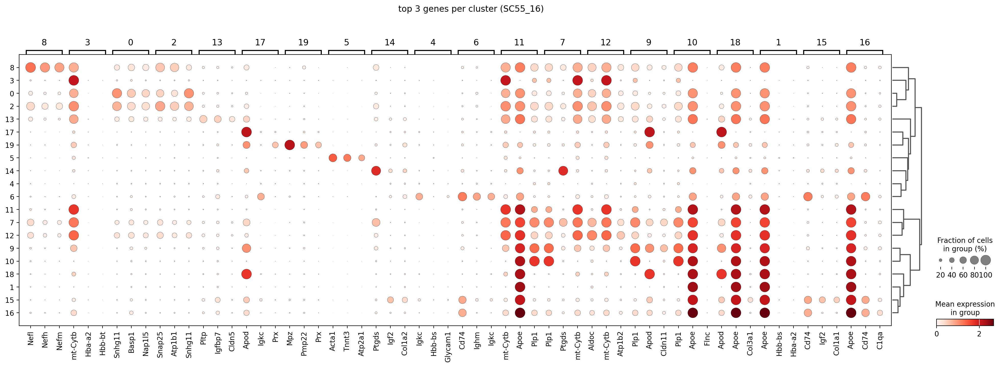

In [17]:
sc.pl.rank_genes_groups_dotplot(SC55_16_filtered, n_genes=3, save="_rank_genes_groups_dotplot", title="top 3 genes per cluster (SC55_16)")

In [18]:
# write df to csv
genes_df.to_csv(os.path.join(out_dir, "SC55_16_genes.csv"))

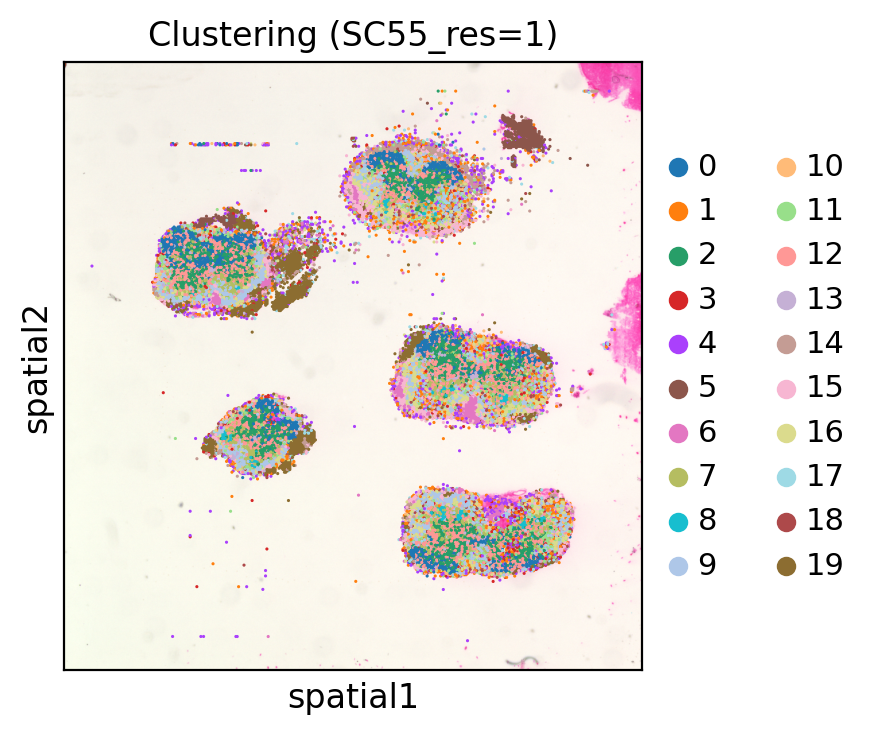

In [19]:
sc.pl.spatial(SC55_16_filtered, color=['leiden'], spot_size=8, save="_leiden_spatial", title="Clustering (SC55_res=1)")

In [72]:
# change colors from default leiden colors to a more visually appealing palette
# this is import when overlaying clusters on the tissue 
default_cluster_colors = SC55_16_filtered.uns['leiden_colors']
bright_colors = [
    '#FF5733',  # Bright Red
    '#33FF57',  # Bright Green
    '#3357FF',  # Bright Blue
    '#FF33A8',  # Bright Pink
    '#FFBD33',  # Bright Orange
    '#75FF33',  # Bright Lime Green
    '#33FFF6',  # Bright Cyan
    '#FF33FF',  # Bright Magenta
    '#FF3396',  # Bright Rose
    '#FF3380',  # Bright Fuchsia
    '#80FF33',  # Bright Yellow-Green
    '#FF3333',  # Bright Scarlet
    '#33FF33',  # Bright Neon Green
    '#3399FF',  # Bright Sky Blue
    '#FF6633',  # Bright Coral
    '#33FFCC',  # Bright Aquamarine
    '#FF33CC',  # Bright Hot Pink
    '#FF9933',  # Bright Saffron
    '#33CCFF',  # Bright Turquoise
    '#33FF99'   # Bright Mint Green
]

# update the colors in the adata object
SC55_16_filtered.uns['leiden_colors'] = bright_colors

In [20]:
# samples on the image can be seen as two columns on the image.
# here is how I label the samples:
# column 1 (left column): top= 1, bottom= 2
# column 2 (right column): top= 3, middle= 4, bottom= 5


# samples coordinates to crop the image for each sample
# 1: [1028:1352, 574:1062] -> in the format of (left, right, top, bottom) == (574,1062,1028,1352)
# 2: [1489:1757, 700:1055] -> (700,1055,1489,1757)
# 3: [774:1146, 1074:1617]  -> (1074,1617,774,1146)
# 4: [1254:1743, 1215:1754] -> (1215,1754,1254,1743)
# 5: [1729:2023, 1222:1709] -> (1222,1709,1729,2023)


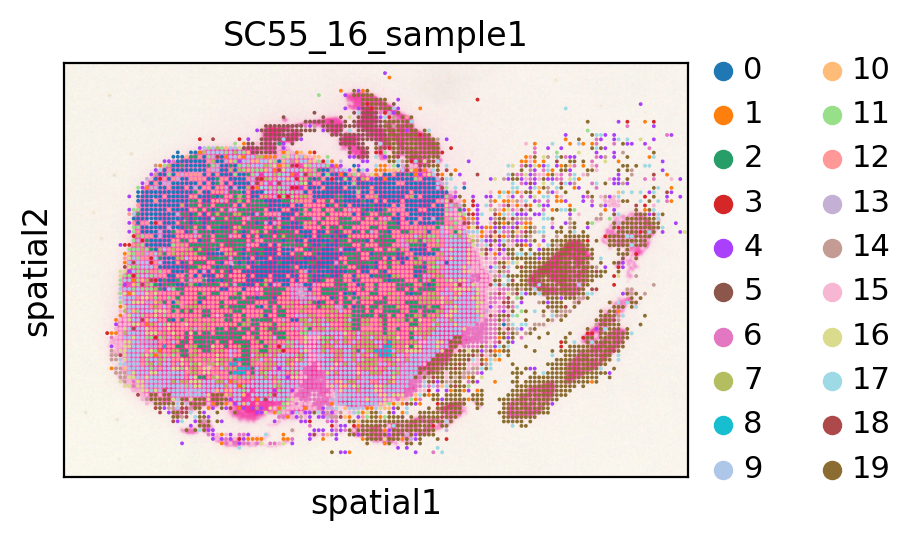

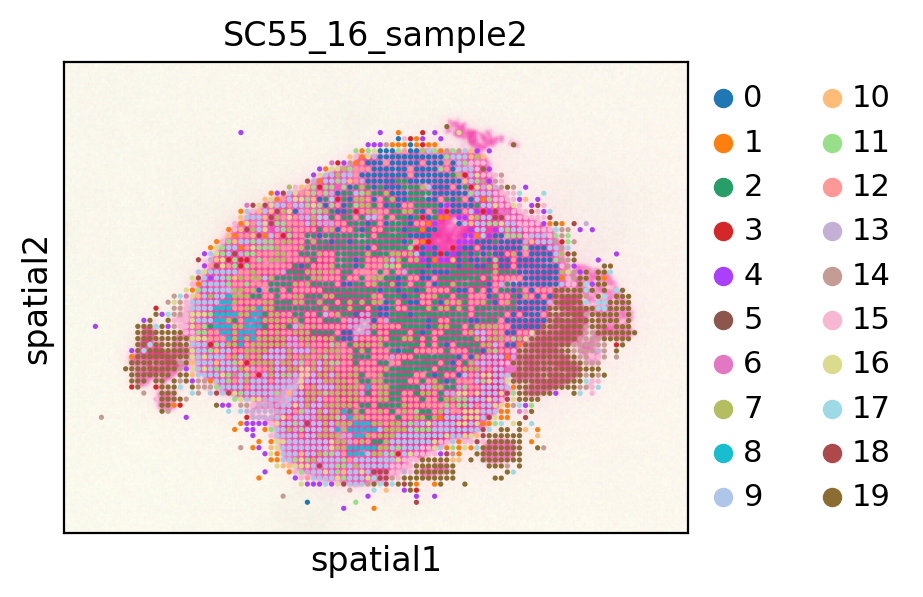

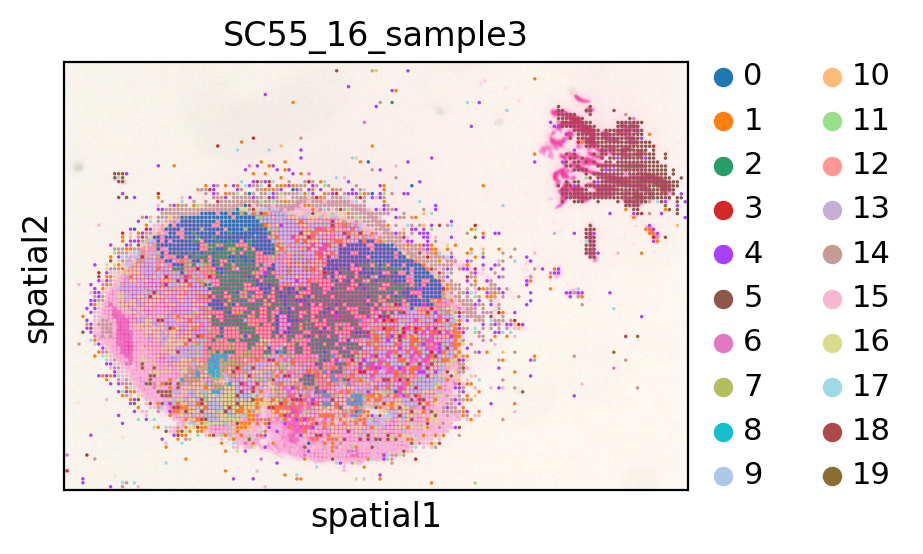

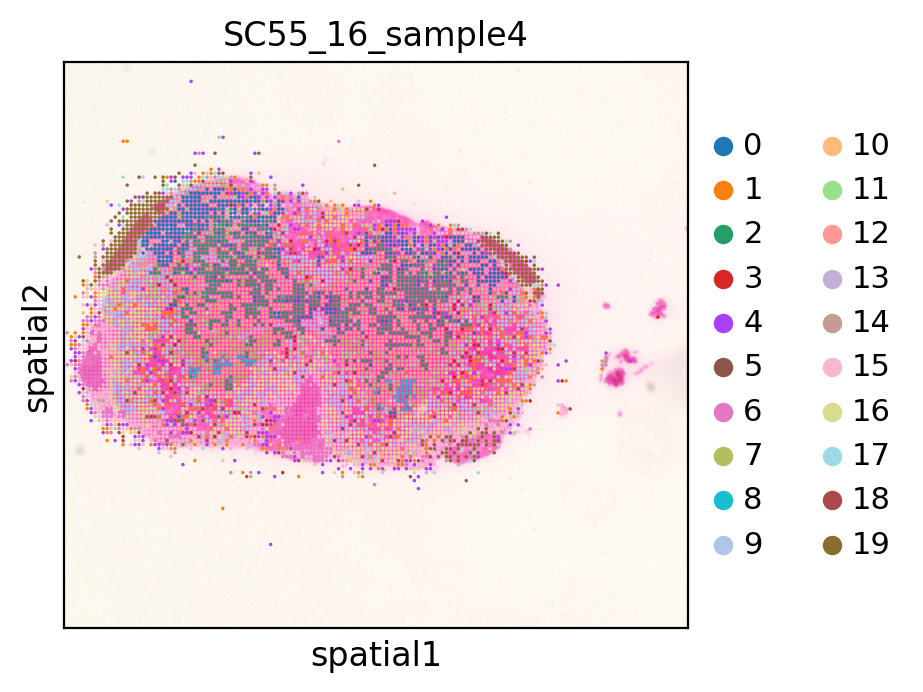

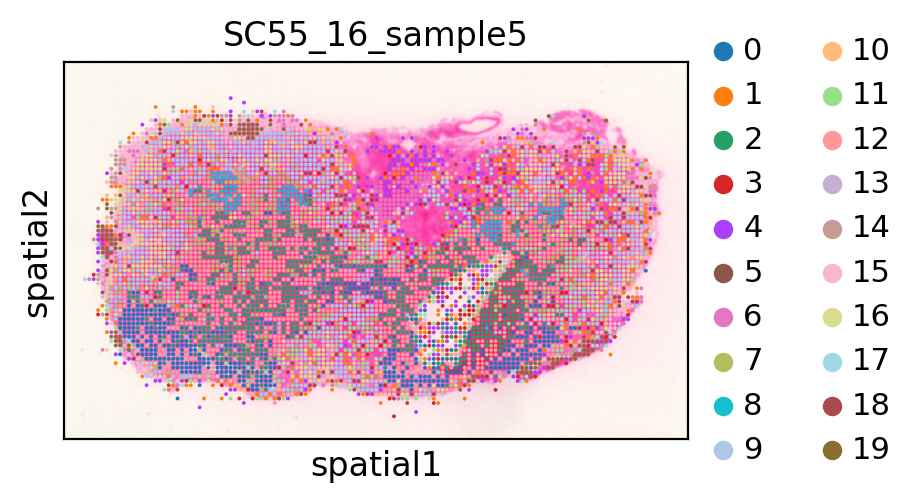

In [21]:
# get image for each sample    
sc.pl.spatial(SC55_16_filtered, color=['leiden'], spot_size=3, crop_coord=[574,1062,1028,1352], title="SC55_16_sample1", save="_sample1_cluster")
sc.pl.spatial(SC55_16_filtered, color=['leiden'], spot_size=3, crop_coord=[700,1055,1489,1757], title="SC55_16_sample2", save="_sample2_cluster")
sc.pl.spatial(SC55_16_filtered, color=['leiden'], spot_size=3, crop_coord=[1074,1617,774,1146], title="SC55_16_sample3", save="_sample3_cluster")
sc.pl.spatial(SC55_16_filtered, color=['leiden'], spot_size=3, crop_coord=[1215,1754,1254,1743], title="SC55_16_sample4", save="_sample4_cluster")
sc.pl.spatial(SC55_16_filtered, color=['leiden'], spot_size=3, crop_coord=[1222,1709,1729,2023], title="SC55_16_sample5", save="_sample5_cluster")

In [22]:
# subset data for each sample

def subset_data(adata, crop_coord):
    """
    adata: AnnData object
    crop_coord: list of coordinates to crop the image (left, right, top, bottom)

    return: subsetted AnnData object
    """
    # Get spatial coordinates
    spatial_coords = adata.obsm['spatial']

    # Create a mask for filtering
    mask = (
        (spatial_coords[:, 0] >= crop_coord[0]) & (spatial_coords[:, 0] <= crop_coord[1]) & 
        (spatial_coords[:, 1] >= crop_coord[2]) & (spatial_coords[:, 1] <= crop_coord[3])
    )

    # Subset the AnnData object
    adata_subset = adata[mask].copy()

    return adata_subset

# crop coordinates for each sample
crop_coord1 = [574,1062,1028,1352]
crop_coord2 = [700,1055,1489,1757]
crop_coord3 = [1074,1617,774,1146]
crop_coord4 = [1215,1754,1254,1743]
crop_coord5 = [1222,1709,1729,2023]

# subset data for each sample
SC55_16_sample1 = subset_data(SC55_16_filtered, crop_coord1)
SC55_16_sample2 = subset_data(SC55_16_filtered, crop_coord2)
SC55_16_sample3 = subset_data(SC55_16_filtered, crop_coord3)
SC55_16_sample4 = subset_data(SC55_16_filtered, crop_coord4)
SC55_16_sample5 = subset_data(SC55_16_filtered, crop_coord5)


In [23]:
SC55_16_sample1

AnnData object with n_obs × n_vars = 6558 × 2000
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_500_genes', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'spatial', 'hvg', 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leiden_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'spatial', 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

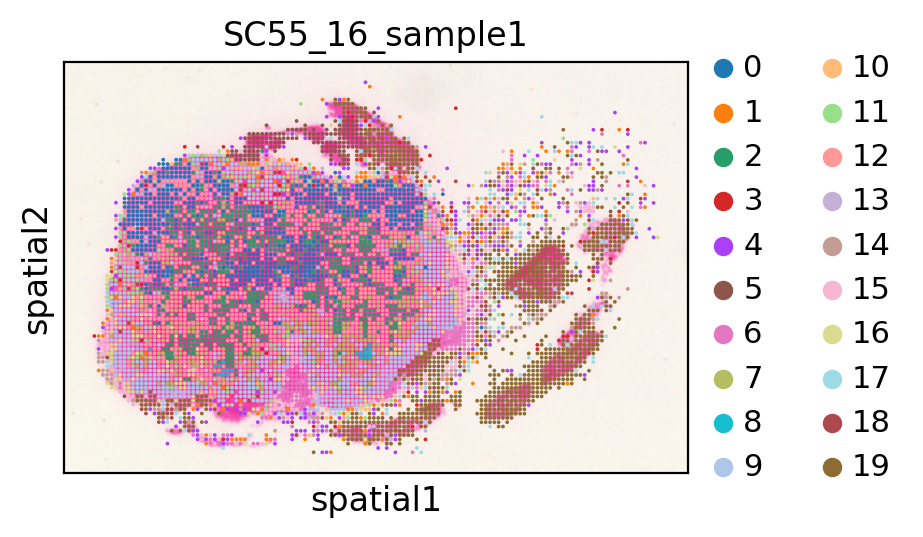

In [24]:
sc.pl.spatial(SC55_16_sample1, color=['leiden'], spot_size=3, title="SC55_16_sample1")

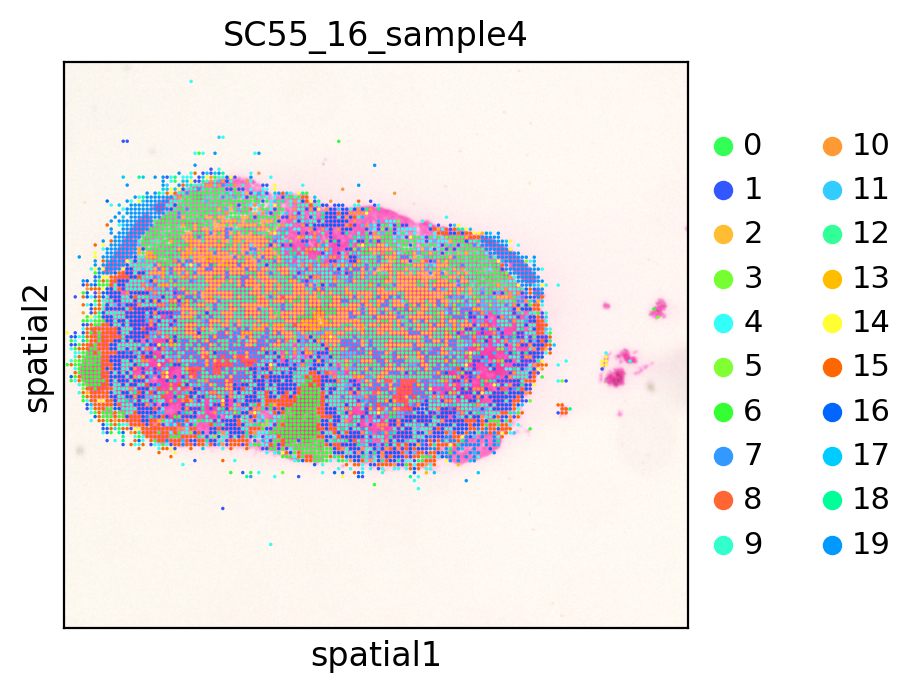

In [74]:
bright_colors = [
    '#FF5733',  # Bright Red
    '#33FF57',  # Bright Green
    '#3357FF',  # Bright Blue
    '#FF33A8',  # Bright Pink
    '#FFBD33',  # Bright Orange
    '#75FF33',  # Bright Lime Green
    '#33FFF6',  # Bright Cyan
    '#FF33FF',  # Bright Magenta
    '#FF3396',  # Bright Rose
    '#FF3380',  # Bright Fuchsia
    '#80FF33',  # Bright Yellow-Green
    '#FF3333',  # Bright Scarlet
    '#33FF33',  # Bright Neon Green
    '#3399FF',  # Bright Sky Blue
    '#FF6633',  # Bright Coral
    '#33FFCC',  # Bright Aquamarine
    '#FF33CC',  # Bright Hot Pink
    '#FF9933',  # Bright Saffron
    '#33CCFF',  # Bright Turquoise
    '#33FF99'   # Bright Mint Green
]


# Revised list of contrasting bright colors (no reds or pinks)
contrasting_colors = [
    '#33FF57',  # Bright Green
    '#3357FF',  # Bright Blue
    '#FFBD33',  # Bright Orange
    '#75FF33',  # Bright Lime Green
    '#33FFF6',  # Bright Cyan
    '#80FF33',  # Bright Yellow-Green
    '#33FF33',  # Bright Neon Green
    '#3399FF',  # Bright Sky Blue
    '#FF6633',  # Bright Coral (mild orange)
    '#33FFCC',  # Bright Aquamarine
    '#FF9933',  # Bright Saffron (Yellow-Orange)
    '#33CCFF',  # Bright Turquoise
    '#33FF99',  # Bright Mint Green
    '#FFBD00',  # Bright Gold
    '#FFFF33',  # Bright Yellow
    '#FF6600',  # Bright Tangerine
    '#0066FF',  # Bright Royal Blue
    '#00CCFF',  # Bright Electric Blue
    '#00FF99',  # Bright Sea Green
    '#0099FF'   # Bright Azure
]
sc.pl.spatial(SC55_16_filtered, color=['leiden'], spot_size=3, crop_coord=[1215,1754,1254,1743], title="SC55_16_sample4",palette=contrasting_colors)

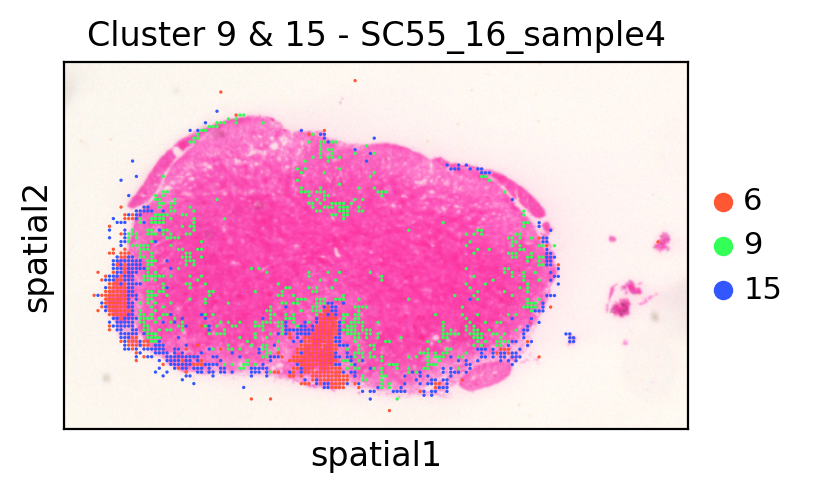

In [68]:
# Create a mask for a cluster
mask_cluster = SC55_16_sample4.obs['leiden'].isin(['9', '15', '6']) # cluster 9 and 15
# Subset data
SC55_16_sample1_cluster_subset = SC55_16_sample4[mask_cluster].copy()

# Plot the spatial data for cluster 4
sc.pl.spatial(SC55_16_sample1_cluster_subset, color='leiden', spot_size=3,palette=bright_colors , title="Cluster 9 & 15 - SC55_16_sample4")

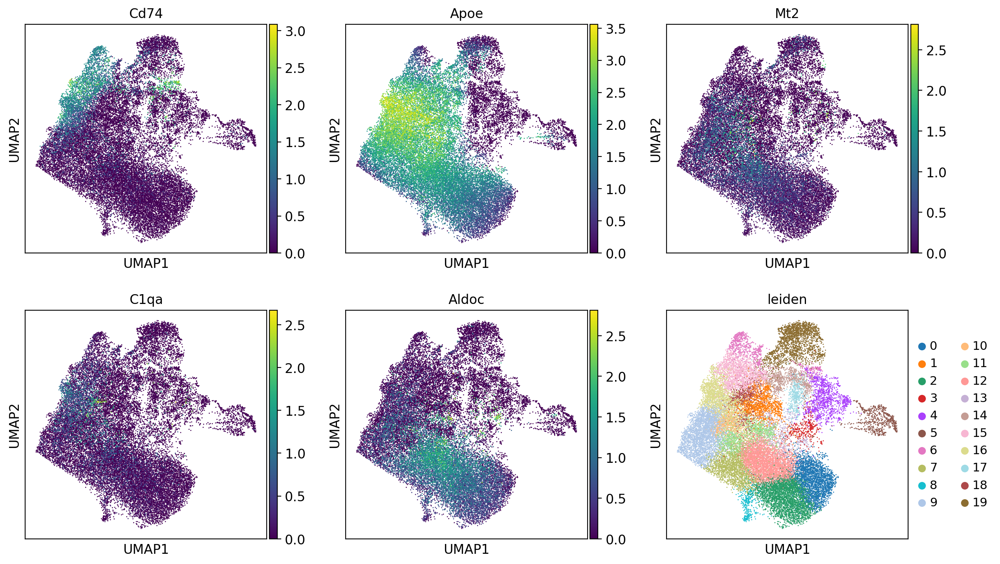

In [26]:
sc.pl.umap(SC55_16_filtered, color = ["Cd74", "Apoe","Mt2", "C1qa","Aldoc", "leiden"] , color_map = 'viridis', ncols = 3)

In [ ]:
# annotation
# taking the first 10 genes from every cluster and searching in pangalodb.org
# 0: Neurons
# 1: oligodendrocytes
# 2: unknown 
# 3: unknown
# 4: Neurons (Trigenimal neurons)
# 5: unknown (Endothelial cells, Macrophages)
# 6: unknown (Neutophils, B cells)
# 7: Fibroblast (Unknown, B cells)
# 8: Fibroblast (smooth muscle cells)
# 9: Macrophages (Unknown, B cells)
# 10: Fibroblast (unknown, oligodendrocytes)
# 11: Oligodendrocytes (Unknown, macrophages)
# 12: Unknown (Fibroblast, Endothelial cells, Astrocytes)
# 13: Unknown (Neurons, Astrocytes, Endothelial cells)
# 14: Unknown (Macrophages, oligodendrocytes)
# 15: Macrophages (B cells, EC)
# 16: Endothelial cells (fibroblast, macrophages)
# 17: Fibroblast (EC, oligodendrocytes)
# 18: Neurons

In [42]:
Bcells = ["Cd19", "Cd79a", "Cd79b", "Ms4a1", "Ighm", "Igkc", "Cd20", "Pax5"] 
Tcells = ["Cd3d", "Cd3e", "Cd8a", "Cd4", "Trac", "Trbc1", "Cd28", "Cd2"]
macrophages = ["Ccl4","Itgam",  "Lyz2"]
microglia = ["Tmem119", "P2ry12", "Aif1", "Cx3cr1", "Csf1r", "Hexb", "Trem2"]

In [43]:
# check if cell type genes are in variable genes
b_cells_genes = [gene for gene in Bcells if gene in SC55_16_filtered.var_names]
t_cells_genes = [gene for gene in Tcells if gene in SC55_16_filtered.var_names]
macrophages_genes = [gene for gene in macrophages if gene in SC55_16_filtered.var_names]
microglia_genes = [gene for gene in microglia if gene in SC55_16_filtered.var_names]


In [55]:
microglia_genes

['Trem2']

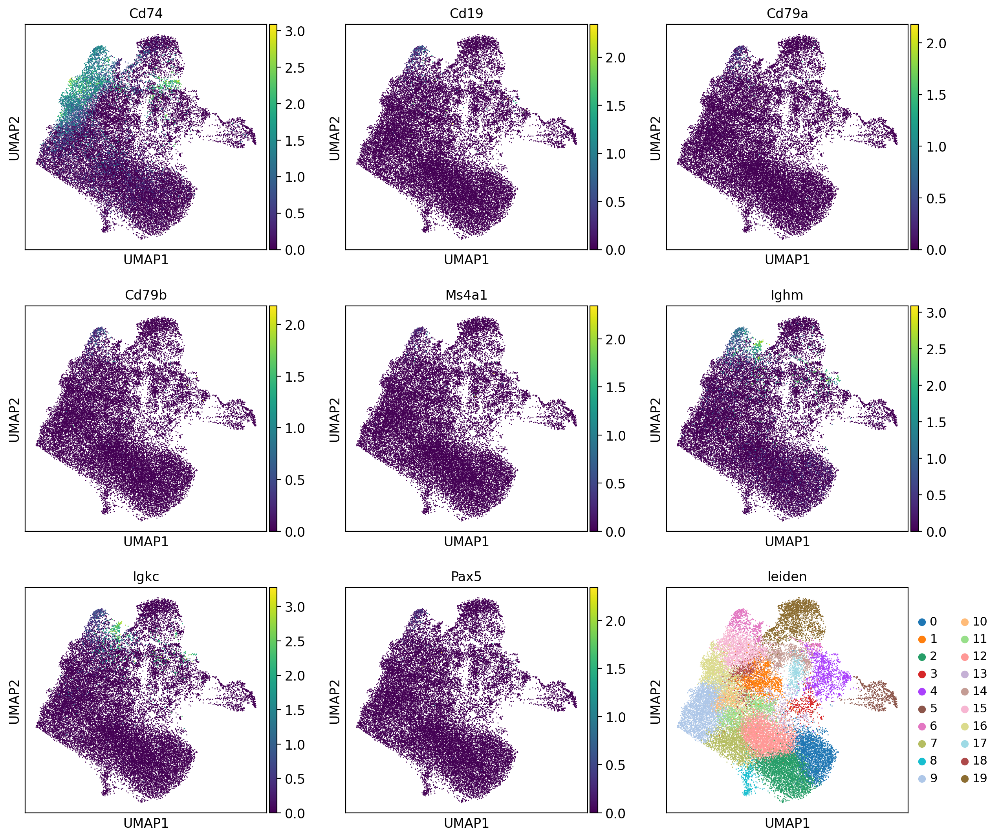

In [50]:
# umap of b_cells_genes and leiden
sc.pl.umap(SC55_16_filtered, color = ["Cd74","Cd19", "Cd79a", "Cd79b", "Ms4a1", "Ighm", "Igkc", "Pax5", "leiden"] , color_map = 'viridis', ncols = 3,save="_b_cells_genes")

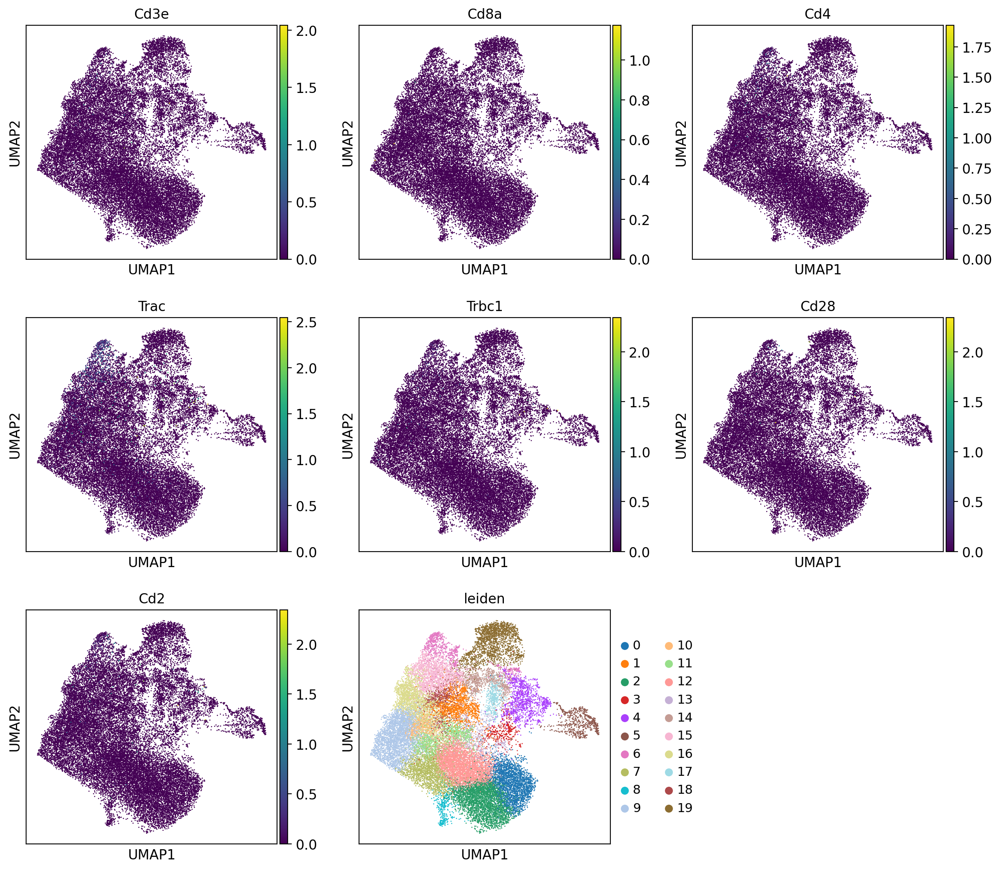

In [52]:
# umap t_cell_genes
sc.pl.umap(SC55_16_filtered, color = ['Cd3e', 'Cd8a', 'Cd4', 'Trac', 'Trbc1', 'Cd28', 'Cd2', "leiden"] , color_map = 'viridis', ncols = 3,save="_t_cells_genes")

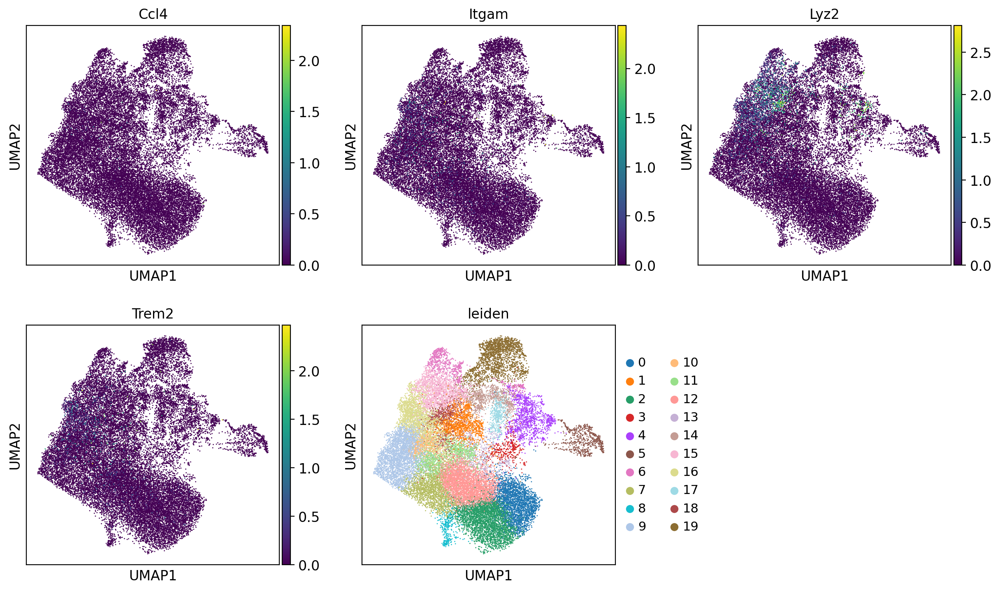

In [56]:
# umap macrophages_genes
sc.pl.umap(SC55_16_filtered, color = ["Ccl4","Itgam",  "Lyz2","Trem2", "leiden"] , color_map = 'viridis', ncols = 3,save="_macrophages_genes")

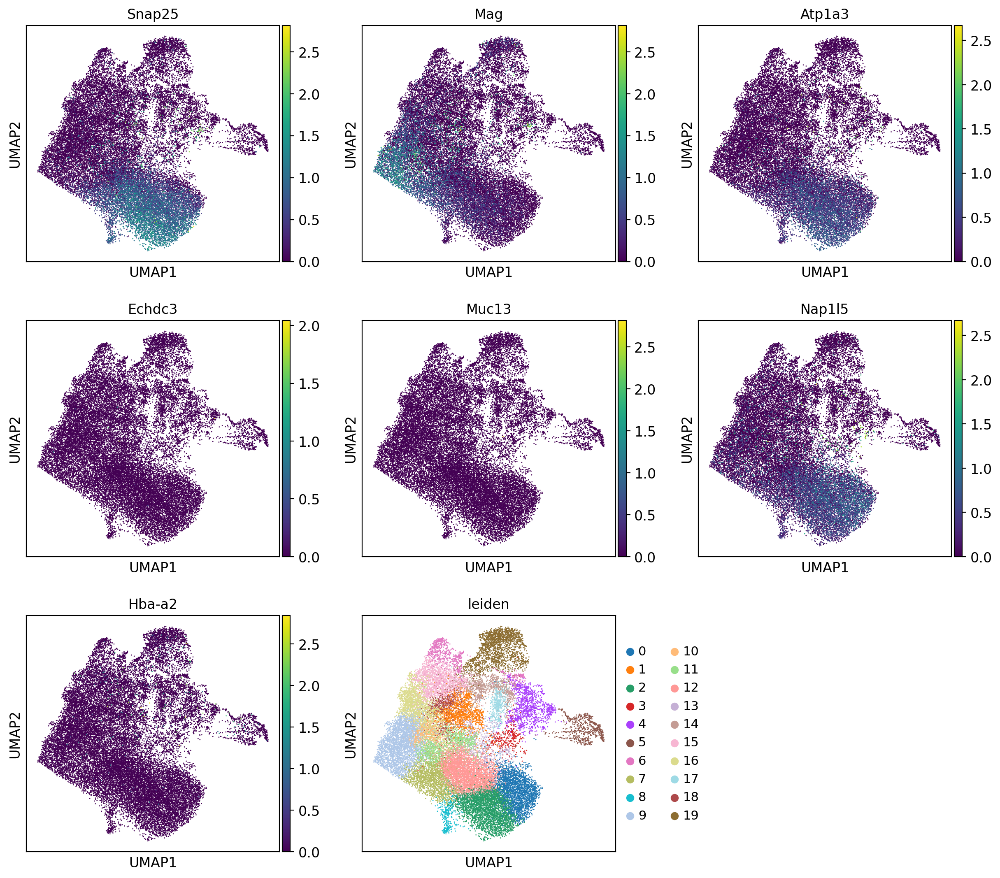

In [58]:
# neurons
sc.pl.umap(SC55_16_filtered, color = ["Snap25", "Mag", "Atp1a3", "Echdc3", "Muc13", "Nap1l5", "Hba-a2", "leiden"] , color_map = 'viridis', ncols = 3,save="_neurons_genes")

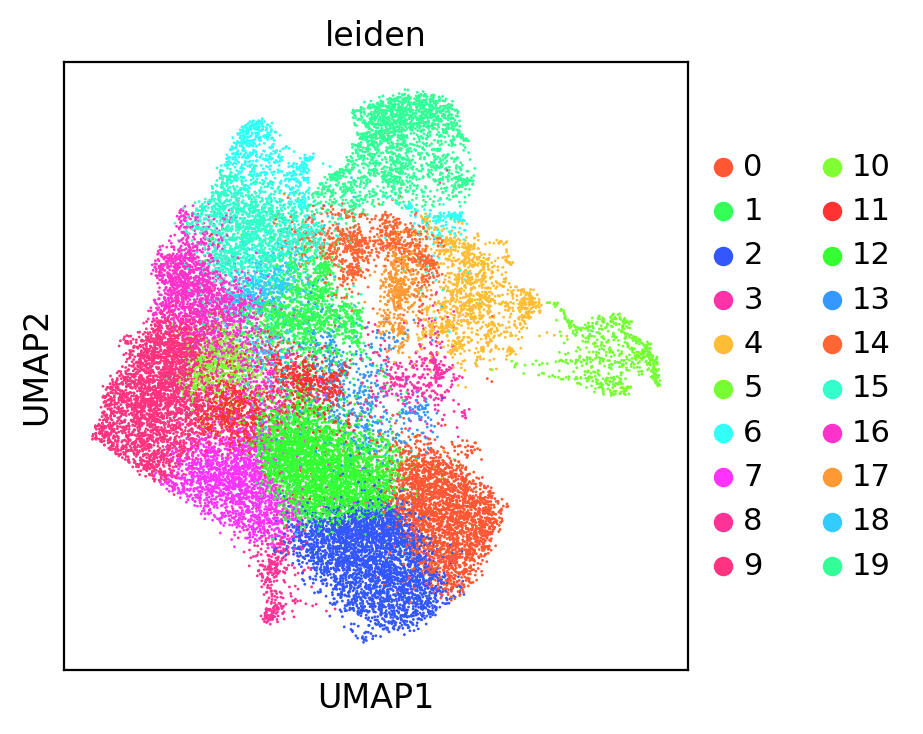

In [65]:
bright_colors = [
    '#FF5733',  # Bright Red
    '#33FF57',  # Bright Green
    '#3357FF',  # Bright Blue
    '#FF33A8',  # Bright Pink
    '#FFBD33',  # Bright Orange
    '#75FF33',  # Bright Lime Green
    '#33FFF6',  # Bright Cyan
    '#FF33FF',  # Bright Magenta
    '#FF3396',  # Bright Rose
    '#FF3380',  # Bright Fuchsia
    '#80FF33',  # Bright Yellow-Green
    '#FF3333',  # Bright Scarlet
    '#33FF33',  # Bright Neon Green
    '#3399FF',  # Bright Sky Blue
    '#FF6633',  # Bright Coral
    '#33FFCC',  # Bright Aquamarine
    '#FF33CC',  # Bright Hot Pink
    '#FF9933',  # Bright Saffron
    '#33CCFF',  # Bright Turquoise
    '#33FF99'   # Bright Mint Green
]

# plot umap with cluster colors
sc.pl.umap(SC55_16_filtered, color='leiden', palette=bright_colors)

## 8micron data

In [13]:
SC55_08_filtered = sc.read_h5ad(os.path.join(data_path, "raw_data/raw_SC55_probe2_long_08.h5ad"))
SC55_08_filtered.var_names_make_unique()

/gpfs/fs1/home/t/tandrew6/btchatch/env/spatial/lib/python3.11/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [14]:
obs_08 = pd.DataFrame(SC55_08_filtered.obsm["spatial"])
obs_08.to_csv(os.path.join(out_dir, "obs_08.csv"), index=False, header=False)

In [24]:
sc.pp.filter_cells(SC55_08_filtered, min_genes=10)
sc.pp.filter_genes(SC55_08_filtered, min_cells=5)
sc.pp.calculate_qc_metrics(SC55_08_filtered, percent_top= [500], log1p=False, inplace=True)
sc.pp.highly_variable_genes(SC55_08_filtered, flavor="seurat_v3", n_top_genes=2000, inplace=True)
SC55_08_filtered = SC55_08_filtered[:, SC55_08_filtered.var.highly_variable]
SC55_08_filtered

View of AnnData object with n_obs × n_vars = 104088 × 2000
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm'
    uns: 'spatial', 'hvg'
    obsm: 'spatial'

/gpfs/fs1/home/t/tandrew6/btchatch/env/spatial/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


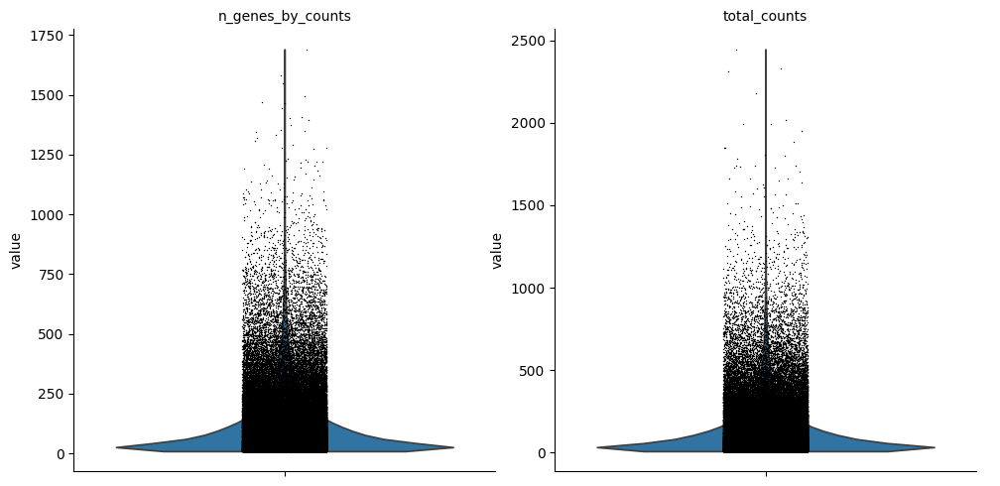

In [25]:
sc.pl.violin(SC55_08_filtered, ['n_genes_by_counts', 'total_counts'],  multi_panel=True)

In [28]:
SC55_08_filtered.obs['total_counts'].describe()

count    104088.000000
mean        135.089401
std         160.719818
min           9.000000
25%          33.000000
50%          80.000000
75%         174.000000
max        2446.000000
Name: total_counts, dtype: float64

In [31]:
sc.pp.filter_cells(SC55_08_filtered, min_genes=5)
SC55_08_filtered.obs['total_counts'].describe()

count    75742.000000
mean       176.027710
std        171.050293
min         10.000000
25%         67.000000
50%        121.000000
75%        221.000000
max       2446.000000
Name: total_counts, dtype: float64

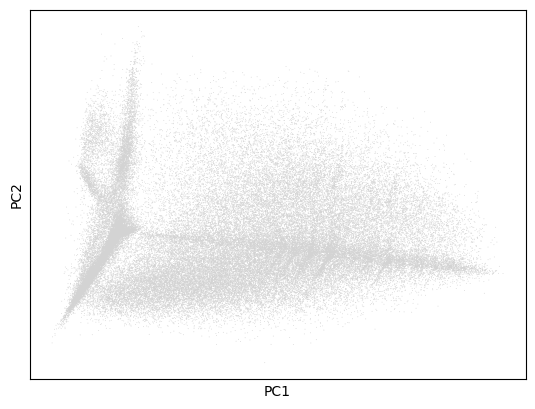

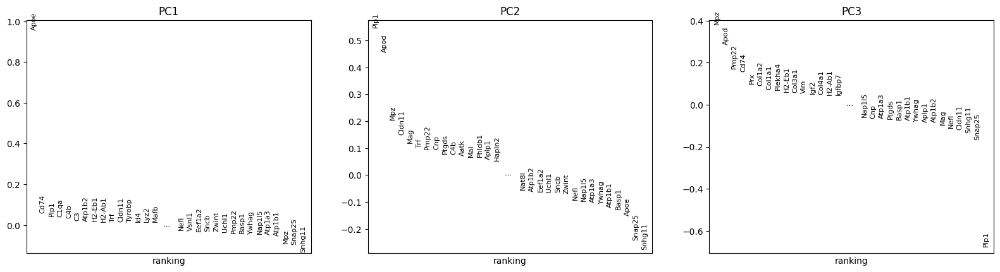

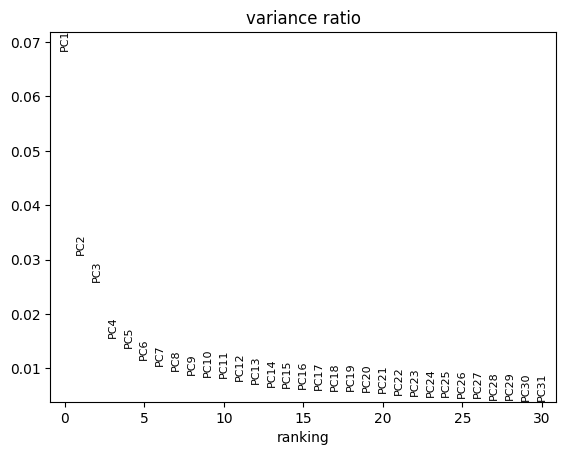

In [33]:
sc.pp.normalize_total(SC55_08_filtered)
sc.pp.log1p(SC55_08_filtered)
sc.tl.pca(SC55_08_filtered, mask_var="highly_variable")
sc.pl.pca_overview(SC55_08_filtered)

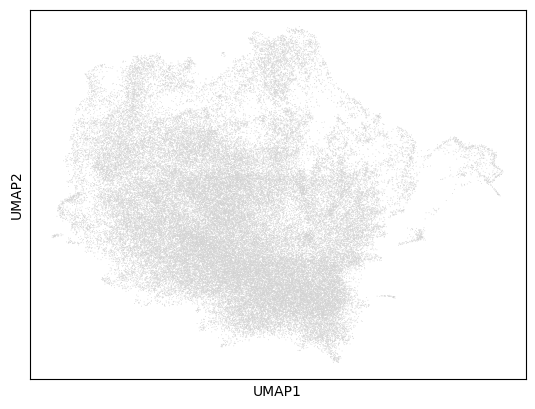

In [34]:
sc.pp.neighbors(SC55_08_filtered)
sc.tl.umap(SC55_08_filtered)
sc.pl.umap(SC55_08_filtered)

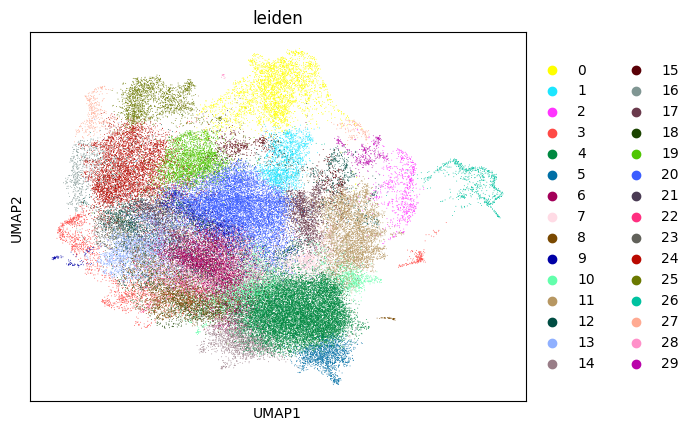

In [35]:
sc.tl.leiden(SC55_08_filtered, flavor= "igraph", n_iterations=2, directed=False)
sc.pl.umap(SC55_08_filtered, color=['leiden'])

In [36]:
sc.tl.rank_genes_groups(SC55_08_filtered, 'leiden', method='wilcoxon')

/gpfs/fs1/home/t/tandrew6/btchatch/env/spatial/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:429: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/gpfs/fs1/home/t/tandrew6/btchatch/env/spatial/lib/python3.11/site-packages/scanpy/tools/_rank_genes_groups.py:431: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/gpfs/fs1/home/t/tandrew6/btchatch/env/spatial/lib/python3.11/site-packages/scanpy/tool

In [37]:
result_08 = SC55_08_filtered.uns['rank_genes_groups']
groups_08 = result_08['names'].dtype.names  # cluster names
genes_df_08 = pd.DataFrame(
    {group: result_08['names'][group] for group in groups_08}
)
genes_df_08.head(10)

,0,1,2,3,4,5,6,7,8,9,...,20,21,22,23,24,25,26,27,28,29
0,Mpz,Apod,Glycam1,Apoe,Snhg11,Snhg11,Atp1b2,Nefl,Apoe,Plp1,...,Plp1,C4b,Ywhag,C1qa,Cd74,Cd74,Acta1,Ighm,Nefm,Col1a2
1,Pmp22,Plp1,Itgal,Csf3r,Snap25,Ly6h,Apoe,Nefh,Nap1l5,Apoe,...,Cldn11,Apoe,Apoe,Apoe,Apoe,Ighm,Tnnt3,Igkc,Stk10,Col1a1
2,Prx,Trf,Hbb-bs,Mafb,Atp1b1,Hap1,Bcan,Nefm,Atp1b1,Id4,...,Mag,Vim,Cplx1,Cd9,H2-Eb1,H2-Eb1,Tpm2,Jchain,Serinc5,Col3a1
3,Apod,Hapln2,Hba-a2,Gpnmb,Atp1a3,Cacna2d1,Gpr37l1,Ywhag,Map1b,Hapln2,...,Apod,Id4,Slco1a4,Mafb,H2-Ab1,H2-Ab1,Atp2a1,Col1a1,Coro6,H2-Eb1
4,Plekha4,Klk6,Lyz2,Tyrobp,Nap1l5,Baiap3,Slc6a11,Map1b,Bcan,Ushbp1,...,Ptgds,C3,Slc6a1,Tyrobp,C1qa,Igkc,Tnnc2,Col1a2,Mdh1,Igf2
5,Col1a2,Mag,Trac,Lyz2,Basp1,Sst,Slc7a10,Snap25,Uchl1,Ccdc88b,...,Cnp,Igfbp7,Ttc28,Unc93b1,H2-Aa,Ighd,Ckm,Lyz2,Mog,H2-Ab1
6,Aatk,Cldn11,Trbc2,Card9,Ywhag,Vsnl1,Fgfr3,Uchl1,Atp1a3,Tyrobp,...,Apoe,A2m,Kit,Aif1,Lyz2,H2-Aa,Pvalb,Igha,Tmeff2,Lyz2
7,Ahnak,Cnp,Ccl19,Cyth4,Sncb,Camkv,Nefl,Atp1b1,Aplp1,Inpp5d,...,Phldb1,Myoc,Adgrf5,Lyz2,C3,Man1a,Mylpf,H2-Eb1,Kifc2,Dcn
8,Cd9,C4b,Ptprc,Unc93b1,Zwint,Penk,Slc6a1,Cplx1,Zwint,Ddit4l,...,Trf,Rapgef3,Abcc6,Ctsz,Col1a1,Coro1a,Tnni2,Col3a1,Vsnl1,Col6a2
9,Col4a1,Aplp1,Lck,Fyb,Uchl1,Basp1,Ntsr2,Tubb3,Eef1a2,Col9a3,...,Aplp1,Fmod,Slc2a1,Csf3r,Vim,Cd37,Tcap,Igf2,Eno2,Bgn


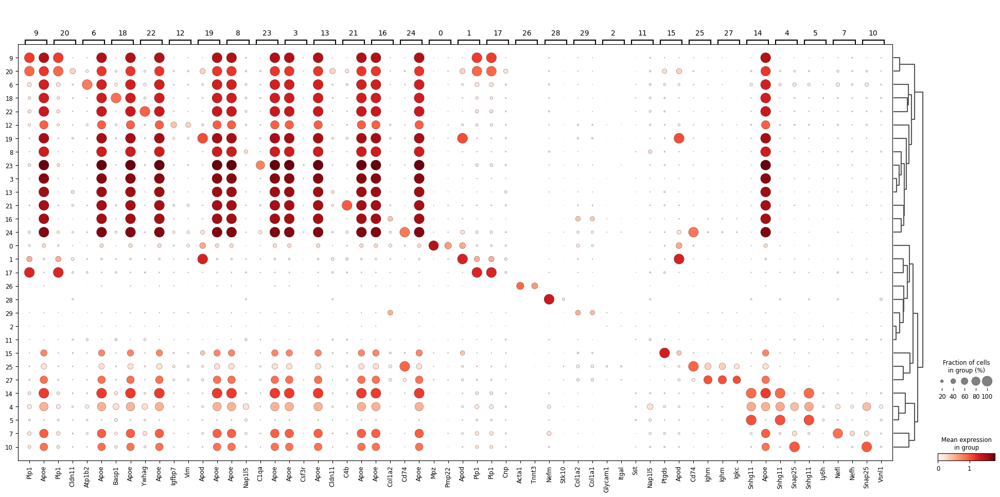

In [40]:
sc.pl.rank_genes_groups_dotplot(SC55_08_filtered, n_genes=2)

In [42]:
# write df to csv
genes_df.to_csv(os.path.join(out_dir, "SC55_16_genes.csv"))
genes_df_08.to_csv(os.path.join(out_dir, "SC55_08_genes.csv"))